In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

img_path = '/export/data/mdorkenw/data/alaska2/'
methods = ['Cover', 'JMiPOD', 'JUNIWARD', 'UERD']

## Select random images for visualization
images = os.listdir(img_path + 'Cover/')
compression = np.load(img_path + 'JPEG_compression.npy')
rand = np.random.randint(0, len(images), 60)
rand_img = [images[i] for i in rand]

## Visualization of difference images

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

IndexError: list index out of range

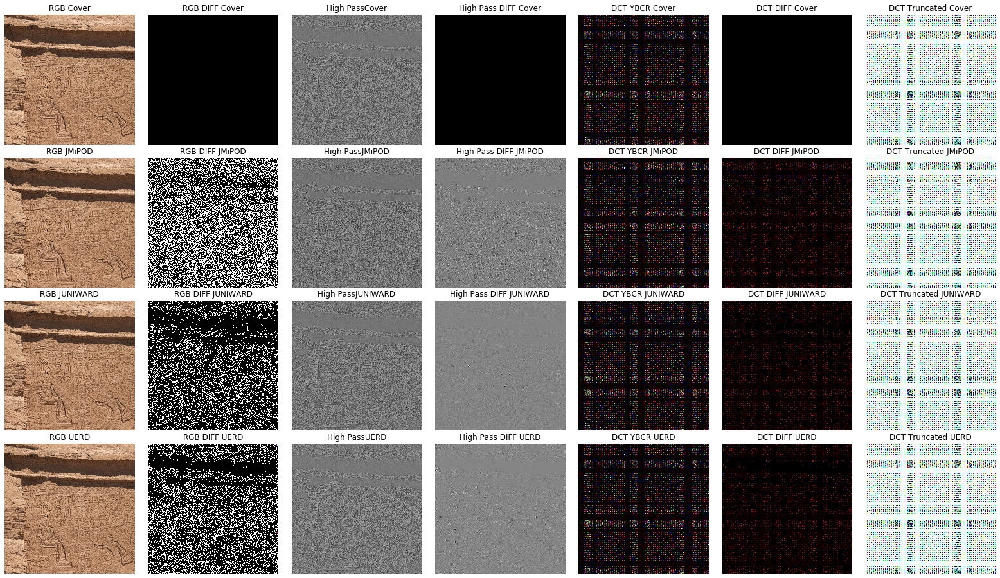

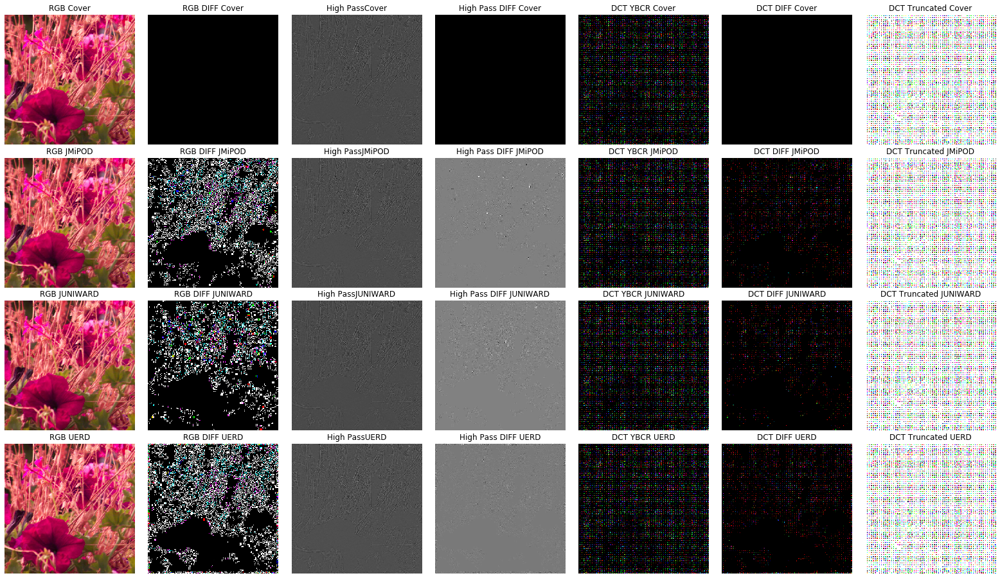

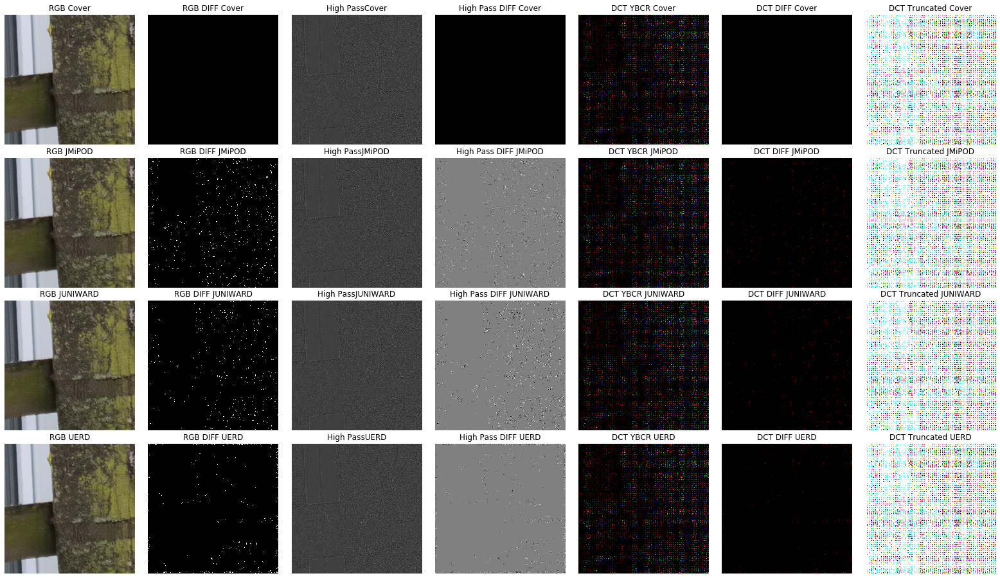

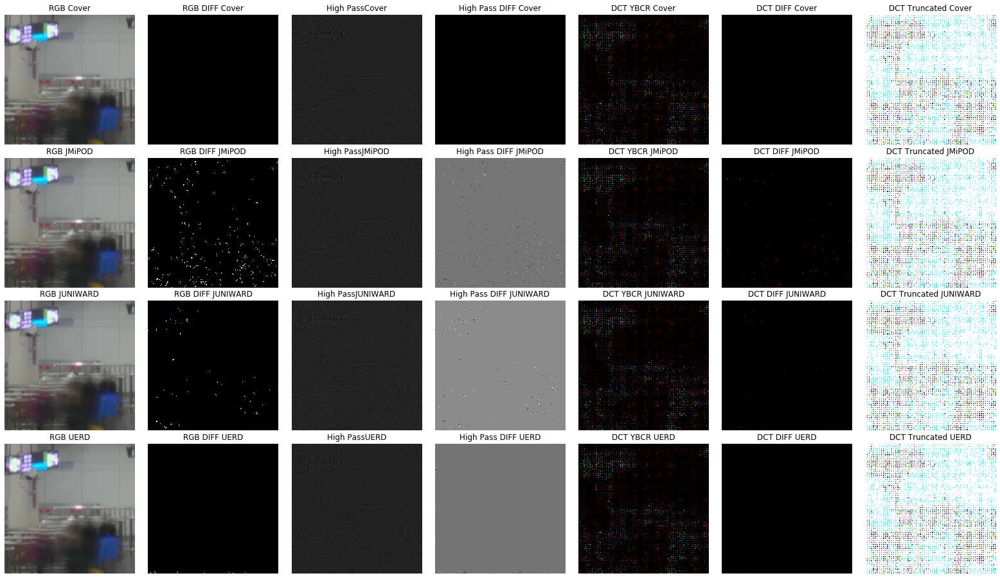

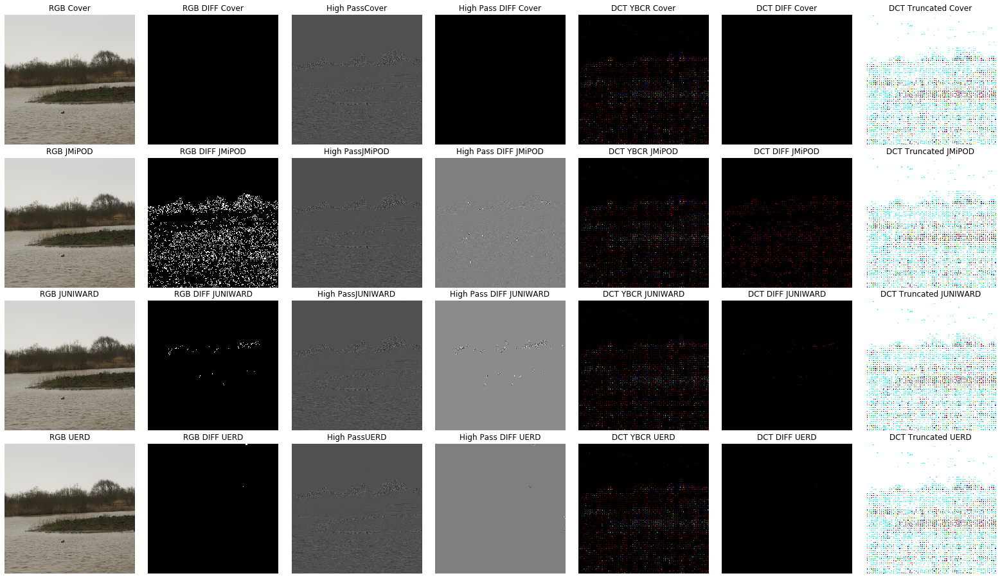

...

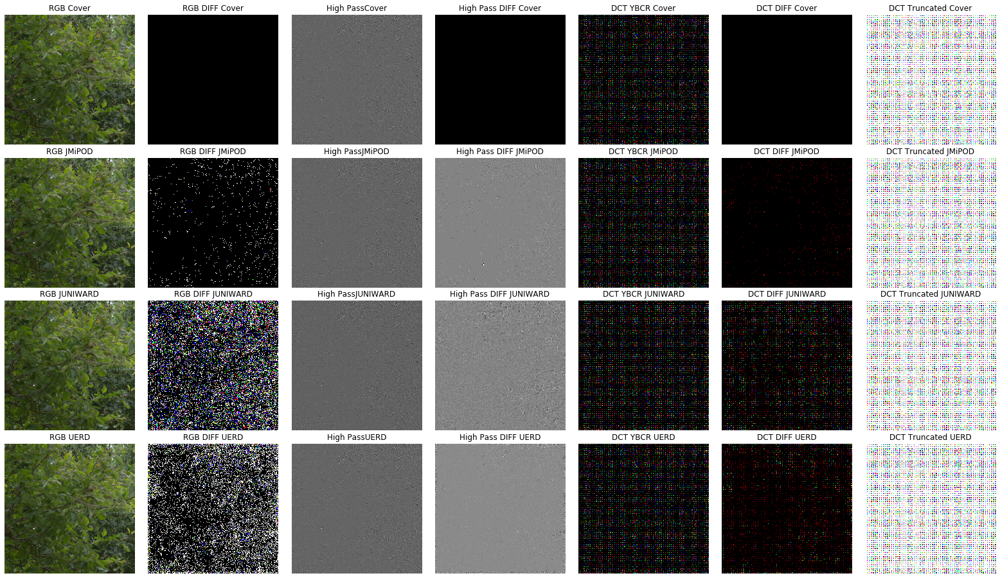

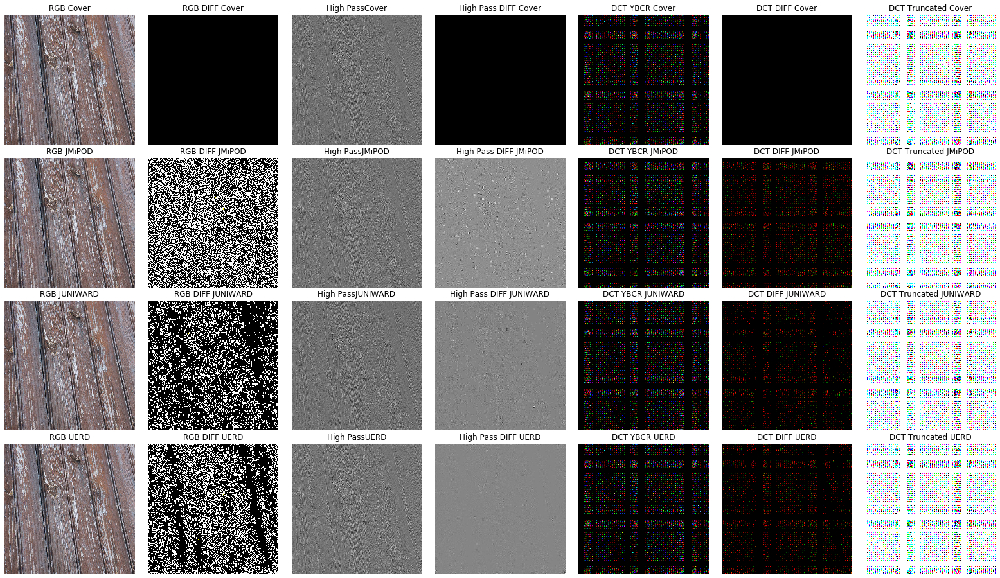

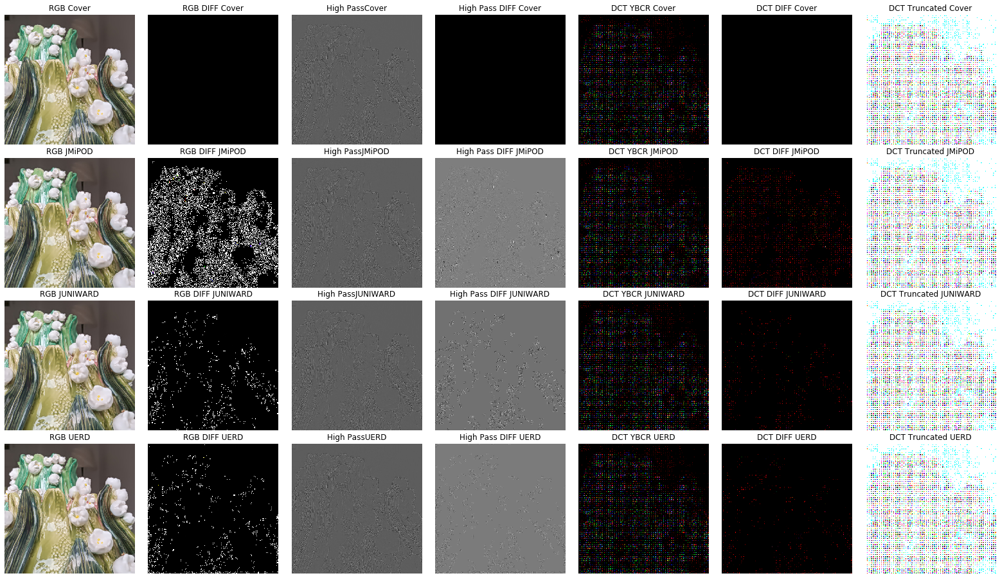

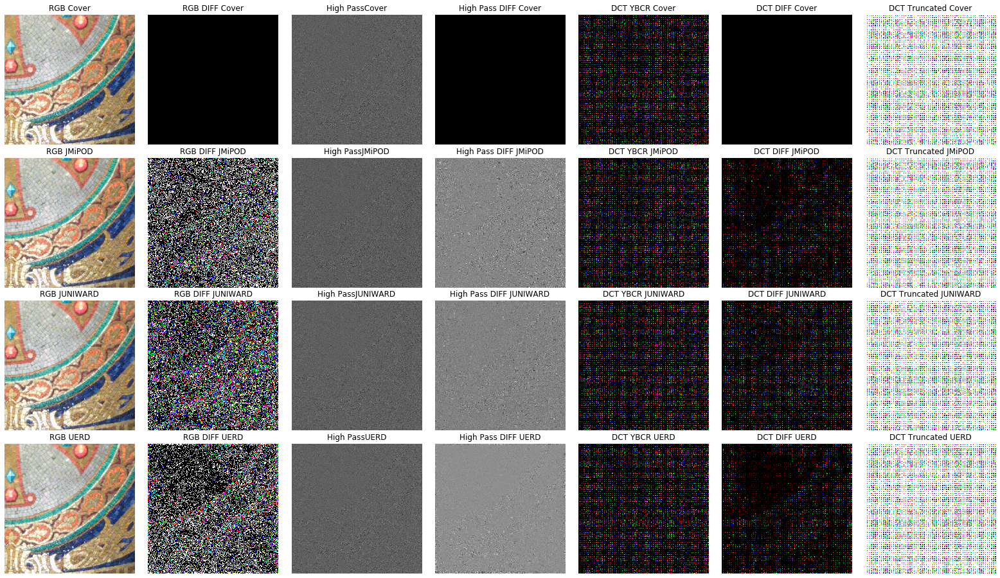

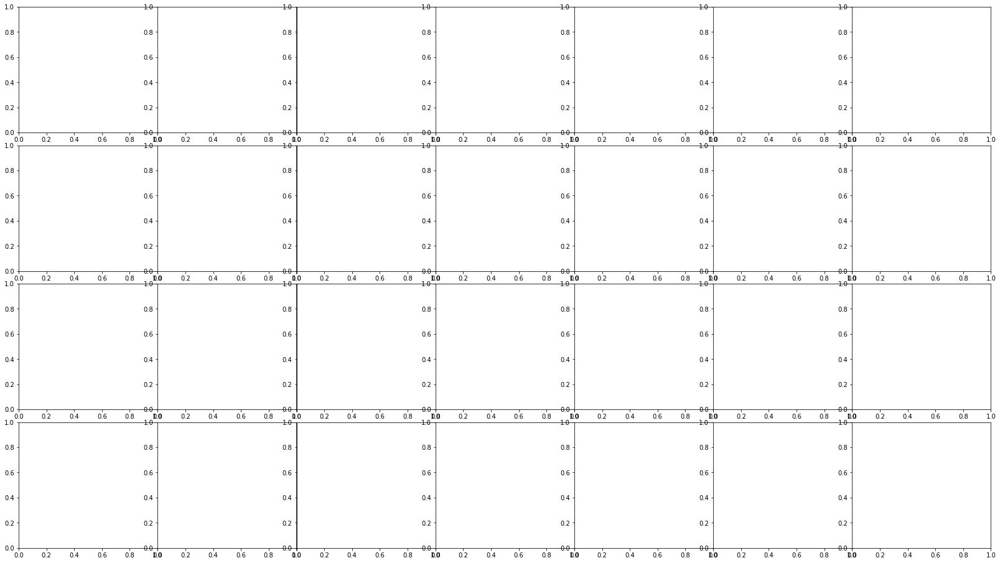

In [4]:
from numpy import r_
from scipy.fftpack import dct

def to_DCT(im):
    def apply_dct(a):
        return dct(dct( a, axis=0, norm='ortho'), axis=1, norm='ortho')
    imsize = im.shape
    dct2 = np.zeros(imsize)

    # Do 8x8 DCT on image (in-place)
    for i in r_[:imsize[0]:8]:
        for j in r_[:imsize[1]:8]:
            dct2[i:(i+8),j:(j+8)] = apply_dct(im[i:(i+8),j:(j+8)])
            dct2[i:(i+8),j:(j+4)] = np.zeros((8,4,3))
            dct2[i:(i+4),j:(j+8)] = np.zeros((4,8,3))
    return dct2

import torch
from torchvision import transforms

high_pass_filter = torch.nn.Conv2d(1, 1, 3, 1, 1, bias=False)
kernel = torch.from_numpy(np.array([[0, -1 / 4, 0], [-1 / 4, 1, -1 / 4], [0, -1 / 4, 0]]))
high_pass_filter.weight = torch.nn.Parameter(kernel.unsqueeze(0).unsqueeze(0).float())

for jo in range(20):
    fig, axs = plt.subplots(4, 7, figsize=(28,16))
    fig.subplots_adjust(hspace = 0.1, wspace=.001)

    methods = ['Cover', 'JMiPOD', 'JUNIWARD', 'UERD']

    images = [Image.open(img_path + met + '/' + rand_img[jo]) for met in methods]

    for i in range(4):
        for j in range(7):
            image = images[i]
            if j == 0:
                axs[i, j].imshow(image)
                axs[i, j].set_title('RGB ' + methods[i])
                axs[i, j].axis('off')
            if j == 1:
                axs[i, j].imshow(np.array(images[0])-np.array(image))
                axs[i, j].set_title('RGB DIFF ' + methods[i])
                axs[i, j].axis('off')
            if j == 2:
                image = high_pass_filter(transforms.ToTensor()(image.convert('L')).unsqueeze(0)).squeeze().detach().numpy()
                axs[i, j].imshow(image, cmap = 'gray')
                axs[i, j].set_title('High Pass' + methods[i])
                axs[i, j].axis('off')
            if j ==3:
                image1 = high_pass_filter(transforms.ToTensor()(image.convert('L')).unsqueeze(0)).squeeze().detach().numpy()
                image2 = high_pass_filter(transforms.ToTensor()(images[0].convert('L')).unsqueeze(0)).squeeze().detach().numpy()
                axs[i, j].imshow(image2-image1, cmap = 'gray')
                axs[i, j].set_title('High Pass DIFF ' + methods[i])
                axs[i, j].axis('off')
            if j == 4:
                image = np.array(image.convert('YCbCr'))
                axs[i, j].imshow(to_DCT(image).astype(float), cmap='gray', vmax = np.max(image)*0.01, vmin = 0)
                axs[i, j].axis('off')
                axs[i, j].set_title('DCT YBCR ' + methods[i])
            if j == 5:
                image = to_DCT(np.array(images[0].convert('YCbCr')))- to_DCT(np.array(image.convert('YCbCr')))
                axs[i, j].imshow(image.astype(float), cmap='gray', vmax = np.max(image)*0.01, vmin = 0)
                axs[i, j].axis('off')
                axs[i, j].set_title('DCT DIFF ' + methods[i])
            if j == 6:
                image = np.array(image.convert('YCbCr'))
#                 image = np.abs(image)/image.max()
                axs[i, j].imshow(1/(to_DCT(image)+1e-3).astype(float), cmap='gray')
                axs[i, j].axis('off')
                axs[i, j].set_title('DCT Truncated ' + methods[i])
                
#             if j == 5:
#                 image = np.array(image)
#                 axs[i, j].imshow(to_DCT(image).astype(float), cmap='gray', vmax = np.max(image)*0.01, vmin = 0)
#                 axs[i, j].axis('off')
#                 axs[i, j].set_title('DCT RGB' + methods[i])
#             if j == 6:
#                 image = to_DCT(np.array(images[0]))- to_DCT(np.array(image))
#                 axs[i, j].imshow(image.astype(float), cmap='gray', vmax = np.max(image)*0.01, vmin = 0)
#                 axs[i, j].axis('off')
#                 axs[i, j].set_title('DCT DIFF RGB' + methods[i])
                
    plt.savefig('visualization/diff_img/img' + str(jo) + '.png', dpi=100)

## Visualization of different JPEG compressions

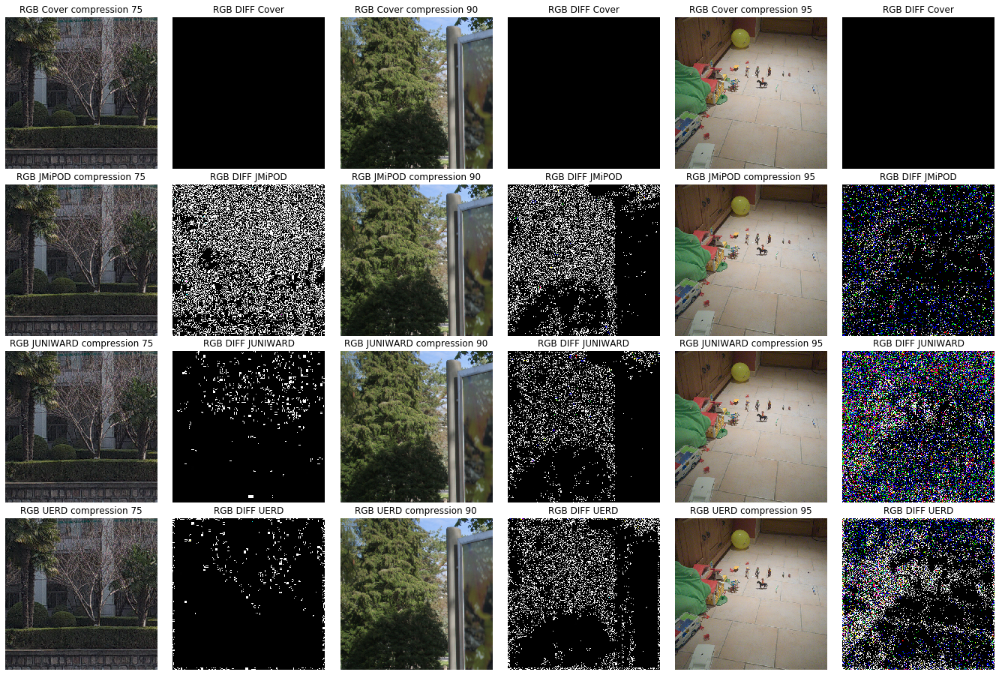

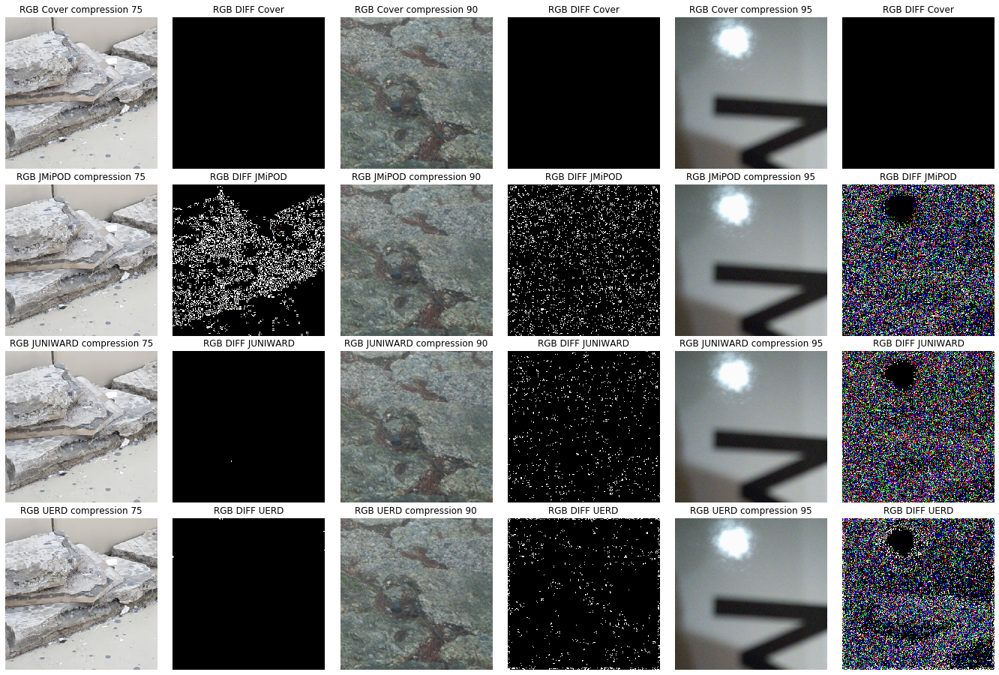

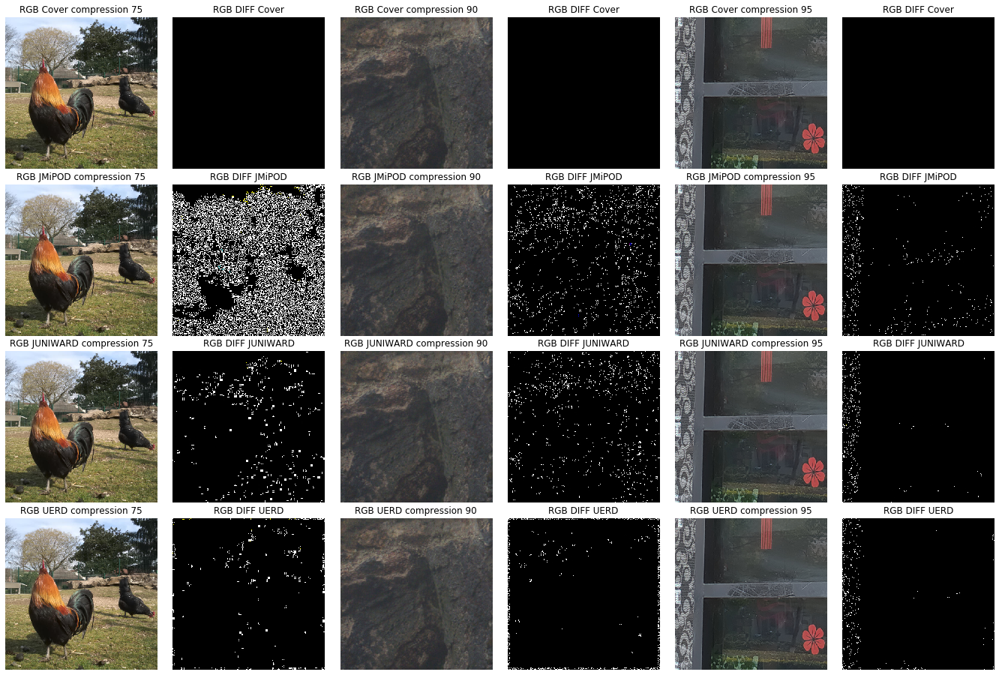

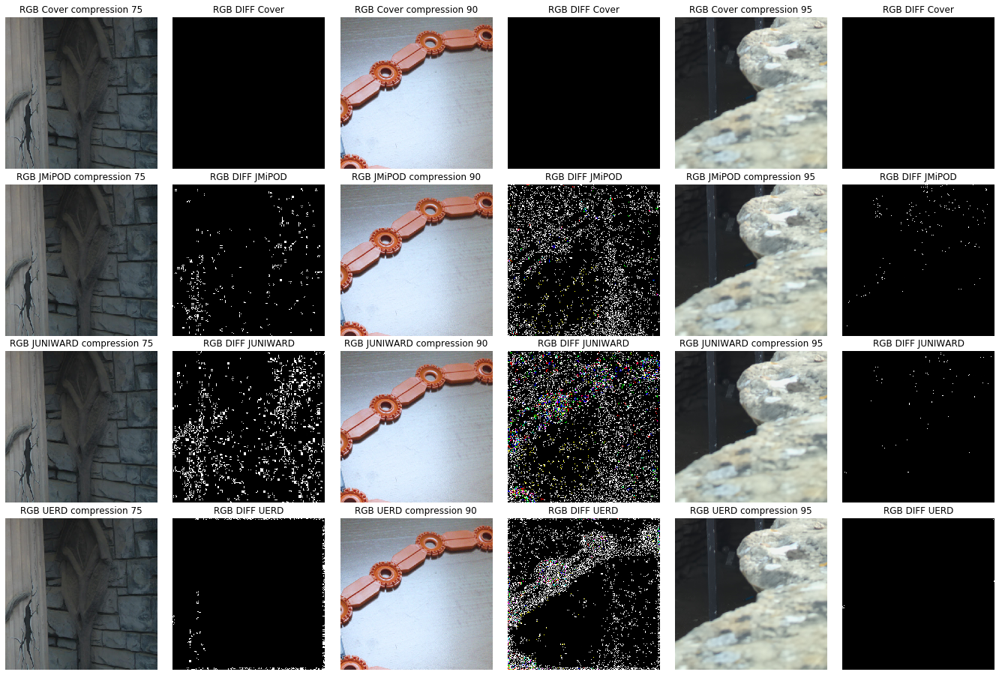

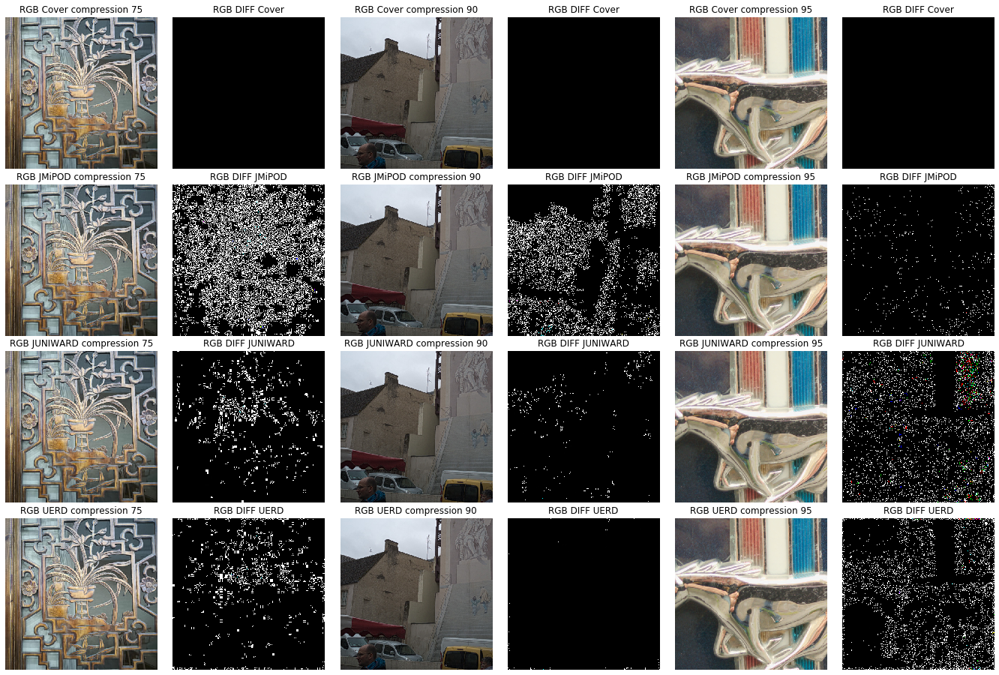

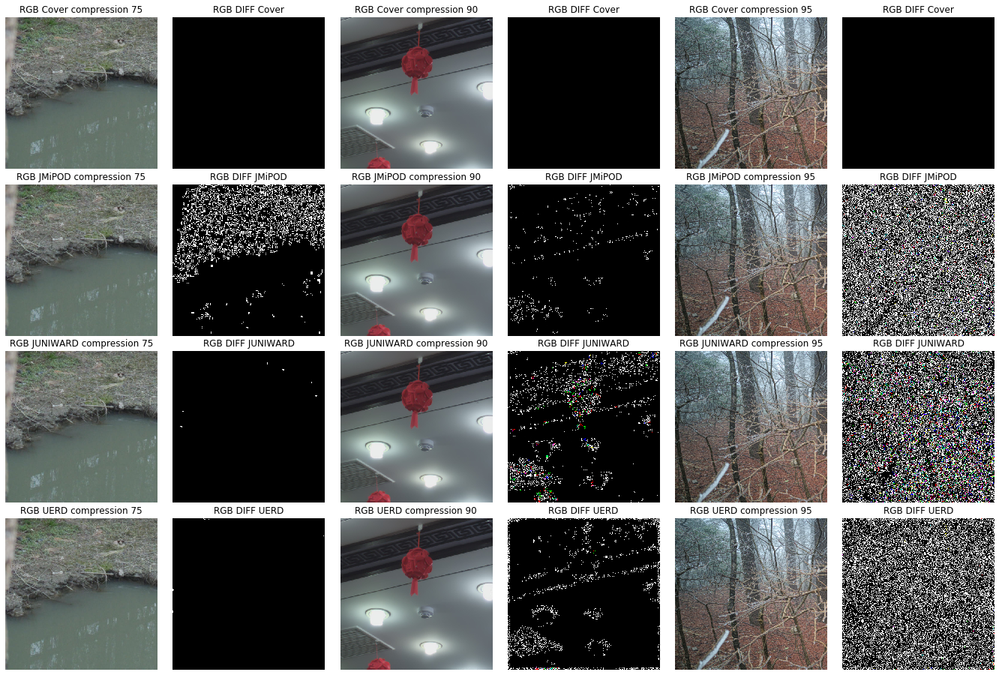

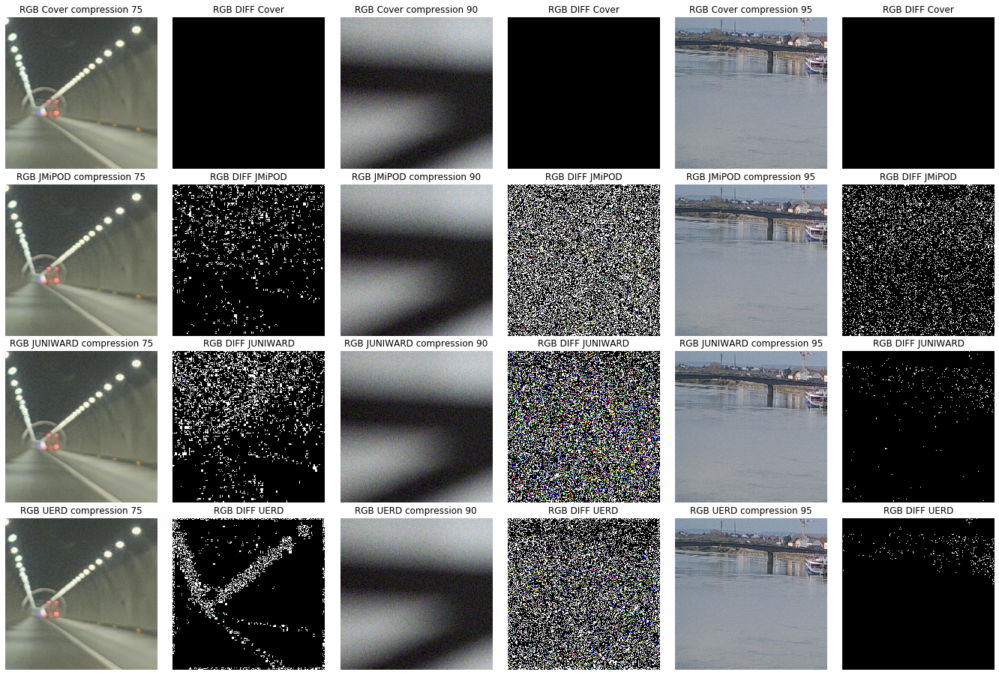

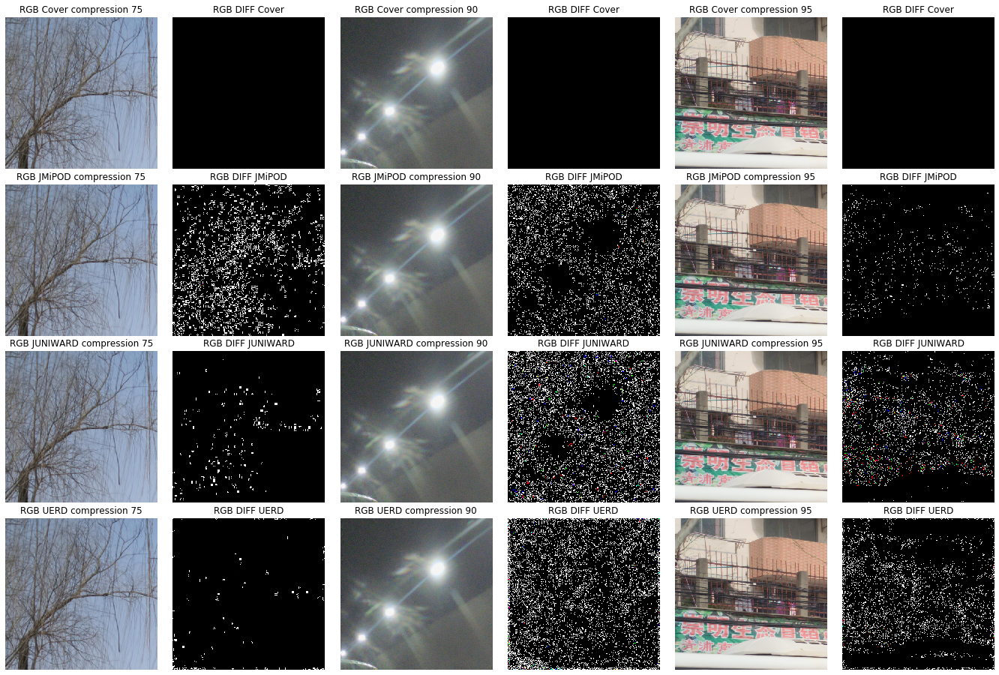

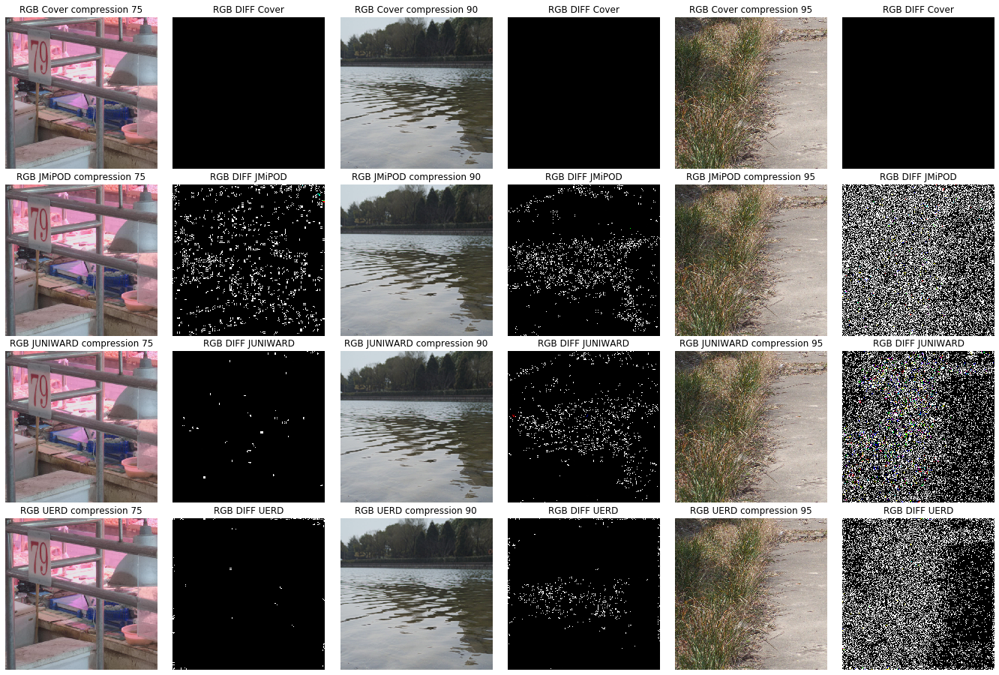

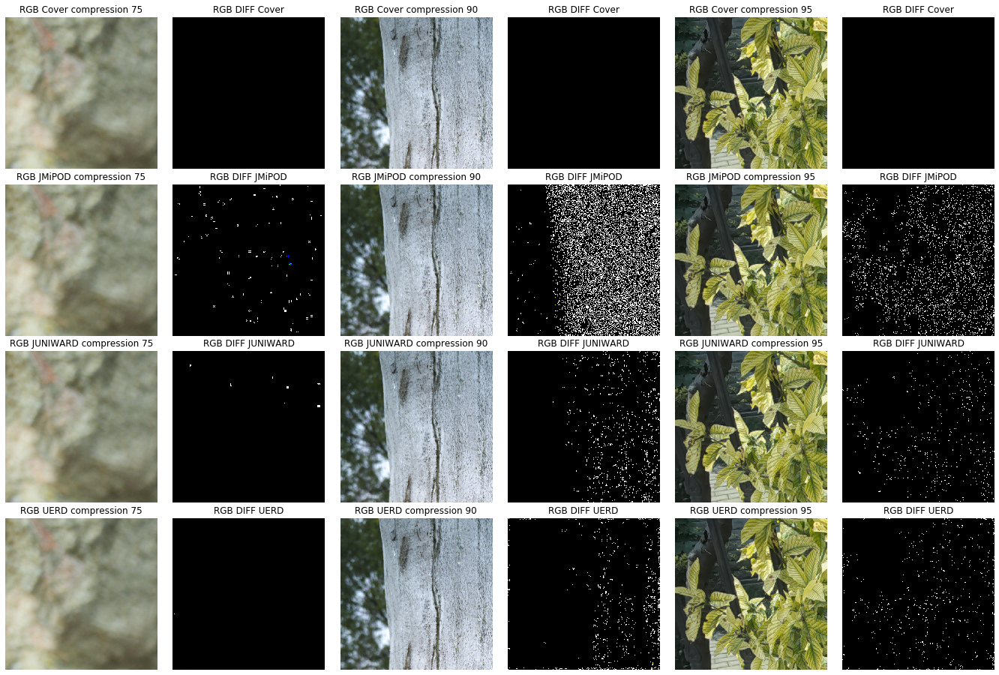

In [47]:
for jo in range(10):
    fig, axs = plt.subplots(4, 6, figsize=(24,16))
    fig.subplots_adjust(hspace = 0.1, wspace=.001)
    for h in range(3):
        methods = ['Cover', 'JMiPOD', 'JUNIWARD', 'UERD']
        compre = ['75', '90', '95']
        index = np.where(compression==h)[0][jo]
        imgs = [Image.open(img_path + met + '/' + images[index]) for met in methods]

        for i in range(4):
            for j in range(2):
                image = imgs[i]
                if j == 0:
                    axs[i, j + h*2].imshow(image)
                    axs[i, j + h*2].set_title('RGB ' + methods[i] + f' compression {compre[h]}')
                    axs[i, j + h*2].axis('off')
                if j == 1:
                    axs[i, j + h*2].imshow(np.array(imgs[0])-np.array(image))
                    axs[i, j + h*2].set_title('RGB DIFF ' + methods[i])
                    axs[i, j + h*2].axis('off')
#     plt.show()
    plt.savefig('visualization/compression/img_' + str(jo) + '.png', dpi=100)

In [59]:
## Cell takes 2.5 h to run all differences between all methods and all compression
diff = [[[], [], [], []], [[], [], [], []], [[], [], [], []]]
from tqdm.notebook import tqdm

for h in range(3):
    index = np.where(compression==h)[0]
    for i in tqdm(range(len(index))):
        imgs = [Image.open(img_path + met + '/' + images[index[i]]) for met in methods]
        for j in range(3):
            diff[h][j].append(np.mean(np.abs(np.array(imgs[0])-np.array(imgs[j+1]))))

In [62]:
diff[0]

[[94.56135940551758,
  42.84628168741862,
  85.62604904174805,
  5.294651031494141,
  78.3743896484375,
  32.996585845947266,
  16.893590291341145,
  30.179359436035156,
  17.293254852294922,
  1.7322362263997395,
  102.34478759765625,
  2.4347623189290366,
  70.24571990966797,
  11.253206888834635,
  10.0906982421875,
  8.899349212646484,
  38.36317571004232,
  23.912965138753254,
  21.018090565999348,
  72.76068115234375,
  81.55836232503255,
  93.1026980082194,
  17.500259399414062,
  47.52188618977865,
  53.45535659790039,
  8.949420928955078,
  4.073143005371094,
  104.81329345703125,
  89.61624526977539,
  73.52144241333008,
  14.004305521647135,
  14.630322774251303,
  63.121177673339844,
  71.41899744669597,
  34.57271194458008,
  81.96829096476237,
  85.15956497192383,
  4.4719085693359375,
  13.838035583496094,
  10.601144154866537,
  37.1558469136556,
  34.42000961303711,
  16.73123550415039,
  46.98344930013021,
  4.4848988850911455,
  32.17090098063151,
  95.35222498575847

In [60]:
diff_mean = []
diff_std = []
for i in range(3):
    for j in range(3):
        diff_mean.append(np.mean(diff[i][j]))
        diff_std.append(np.std(diff[i][j]))
diff_mean, diff_std

([45.088015161488855,
  29.535454923197427,
  26.613158046824136,
  50.46601514912924,
  35.51699588017782,
  35.05327369598389,
  37.17390659525554,
  35.71436800516764,
  36.294103380177816],
 [37.48775417149459,
  31.643869814077373,
  32.45467657937639,
  37.289029284186476,
  34.9135560291177,
  34.947505581947944,
  40.93842981080349,
  33.52671052154356,
  33.76426146894352])

## Visualization of features

Code for visualization is taken from https://github.com/utkuozbulak/pytorch-cnn-visualizations

In [28]:
import sys, torch, os
from tqdm.notebook import tqdm
import numpy as np
model_path = '/export/data/mdorkenw/results/alaska/'
model_name = 'Model_Date-2020-7-16-9-26_Efficientnet-CORRECT_SUBMISSION_125050_SMOOTHING0.2'
sys.path.append(model_path + model_name + '/code')
import network as net
import dataloader 
import auxiliaries as aux
os.environ["CUDA_VISIBLE_DEVICES"] = '0'
config     = aux.extract_setup_info(model_path + model_name + '/code/network_base_setup.txt')[0]
dloader   = dataloader.dataset(config, mode='evaluation')
model = net.Net(config.Network)
pre_model = torch.load(model_path + model_name + '/checkpoint_best_val.pth.tar')
_ = model.load_state_dict(pre_model['state_dict'])

Loaded pretrained weights for efficientnet-b0


Need to change functions to work for our model by renaming stuff.

In [45]:
import sys, torch, os
sys.path.append('/export/home/mdorkenw/code/ALASKA2/scripts/pytorch-cnn-visualizations/src/')
from guided_backprop import GuidedBackprop
from misc_functions import (get_example_params,
                            convert_to_grayscale,
                            save_gradient_images,
                            get_positive_negative_saliency)

def get_grad_imgs(model, prep_img, target_class):
    # Guided backprop
    GBP = GuidedBackprop(model)
    # Get gradients
    guided_grads = GBP.generate_gradients(prep_img.requires_grad_(True), target_class)
    # Save colored gradients
    guided_grads = save_gradient_images(guided_grads, '')
    # Convert to grayscale
    grayscale_guided_grads = convert_to_grayscale(guided_grads)
    # Save grayscale gradients
    grayscale_guided_grads = save_gradient_images(grayscale_guided_grads, '')
    # Positive and negative saliency maps
    pos_sal, neg_sal = get_positive_negative_saliency(guided_grads)
    pos_sal = save_gradient_images(pos_sal, '')
    neg_sal = save_gradient_images(neg_sal, '')
    return [guided_grads, grayscale_guided_grads, pos_sal, neg_sal]

In [48]:
### DUMMY TEST
file_name_to_export = 'visualization/feature/img'
prep_img = dloader.load_and_augment_RGB('/export/home/mdorkenw/code/ALASKA2/scripts/pytorch-cnn-visualizations/input_images/snake.jpg').unsqueeze(0)
target_class = 0
model.cpu()
imgs = get_grad_imgs(model, prep_img, target_class)

/export/home/mdorkenw/code/ALASKA2/scripts/pytorch-cnn-visualizations/src/misc_functions.py:216: RuntimeWarning: invalid value encountered in true_divide
  neg_saliency = (np.maximum(0, -gradient) / -gradient.min())


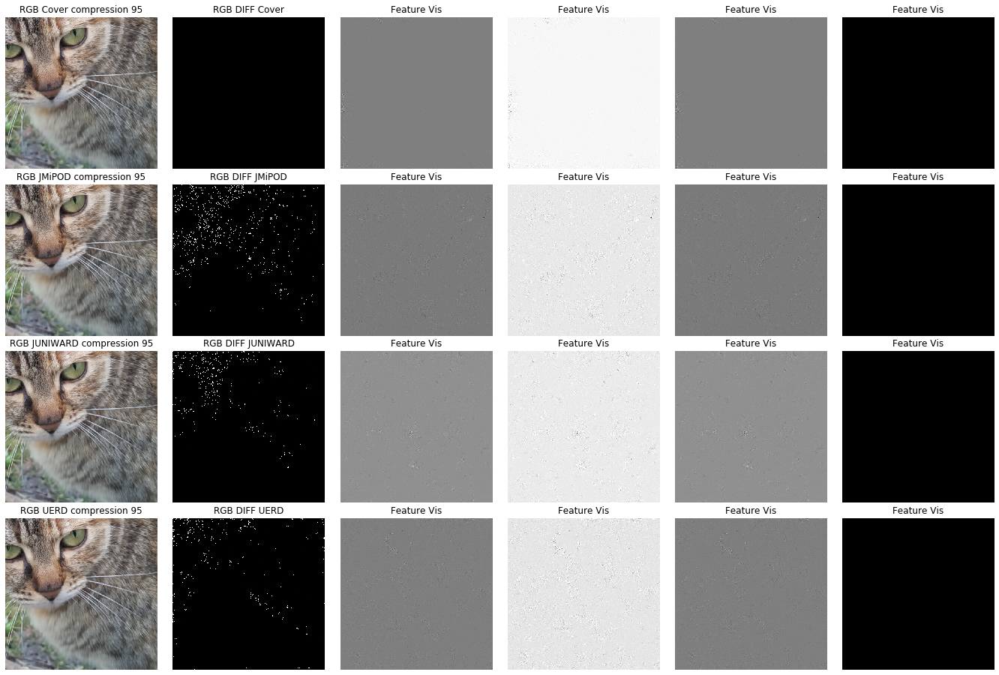

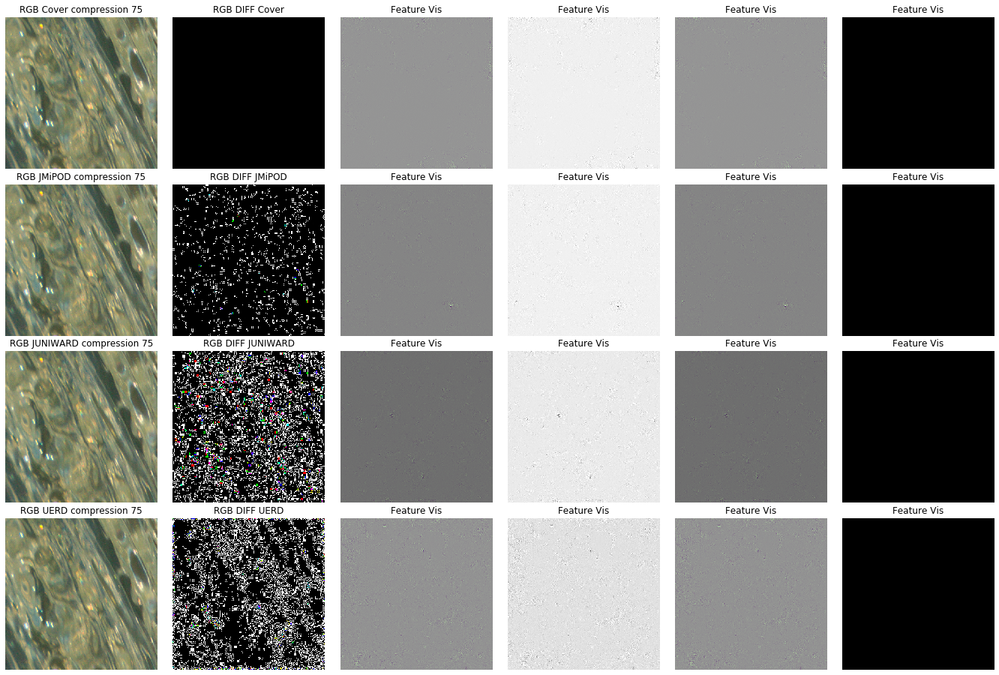

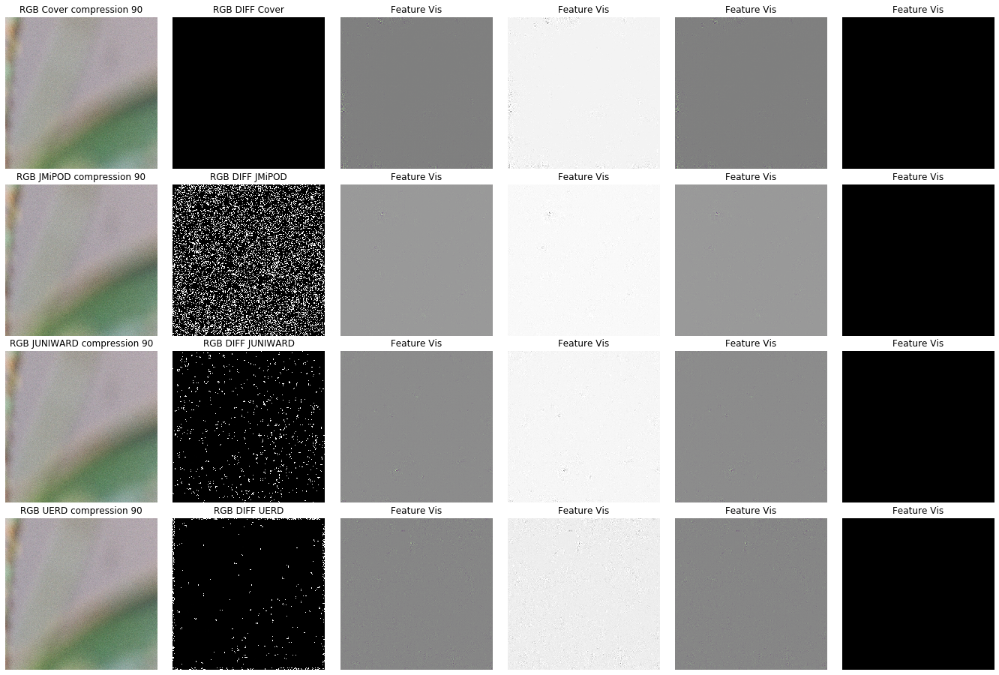

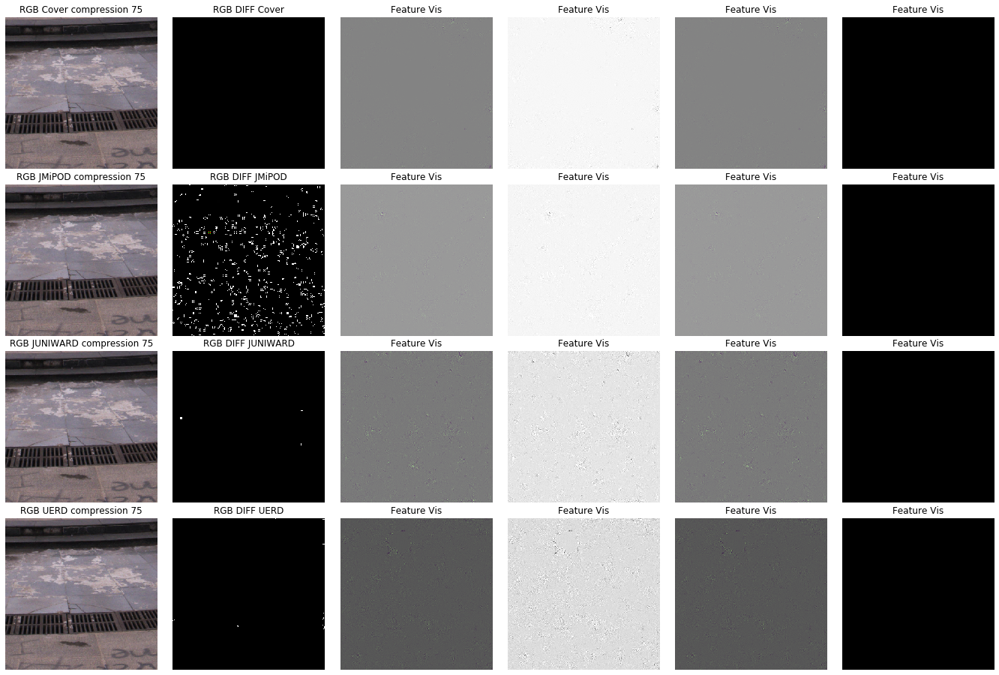

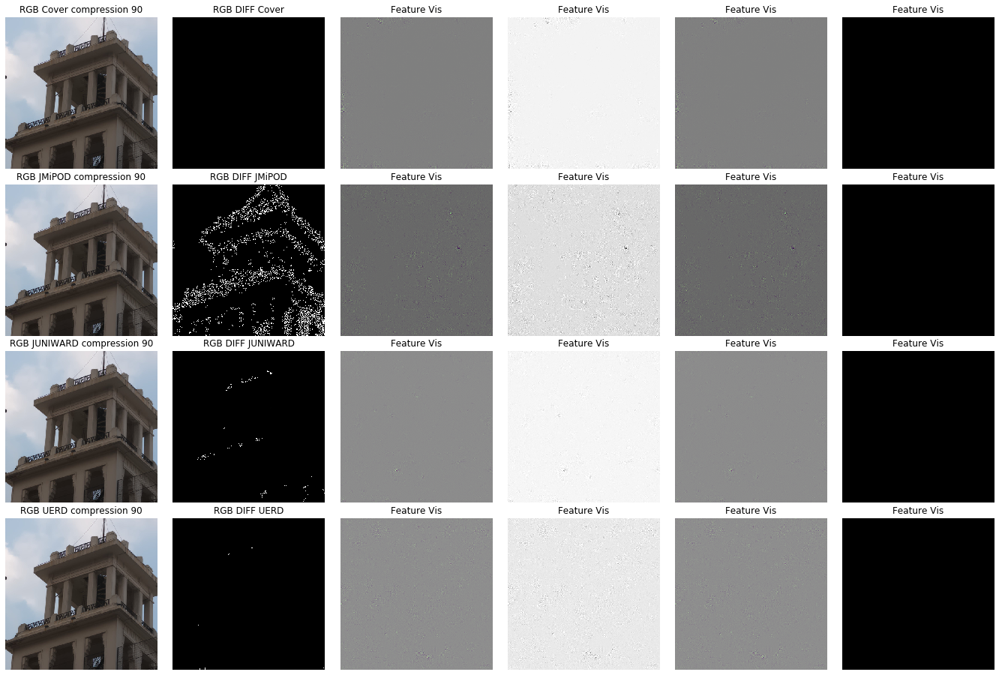

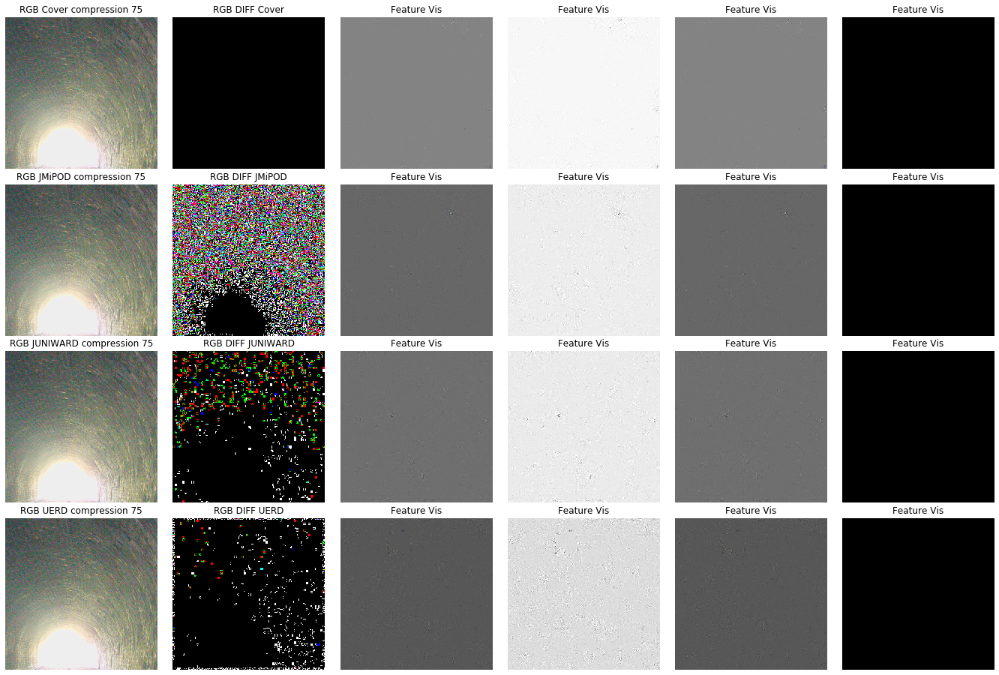

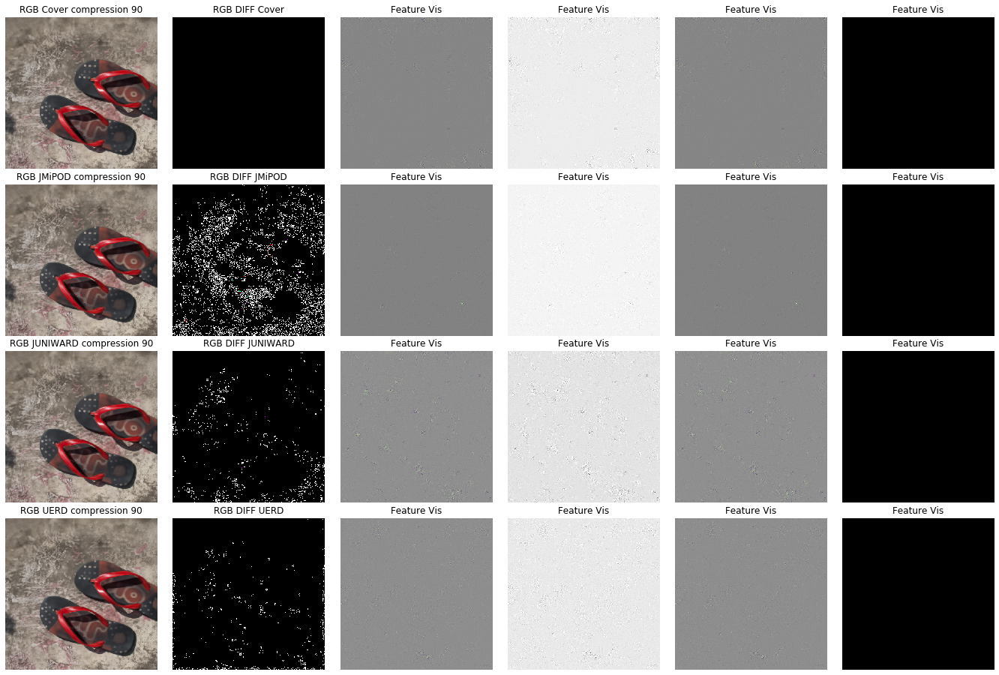

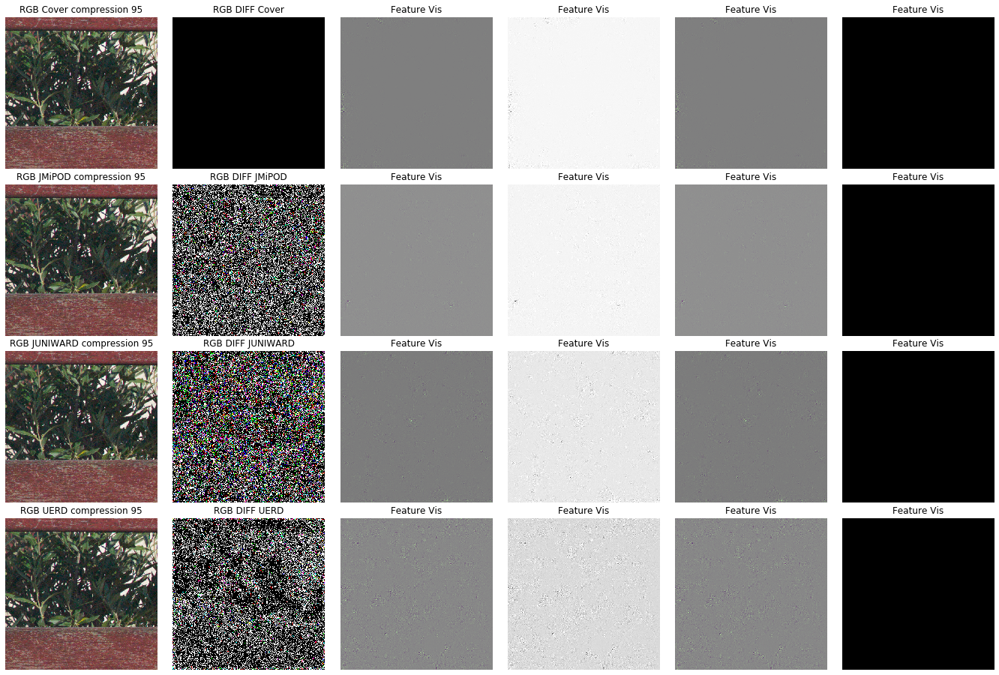

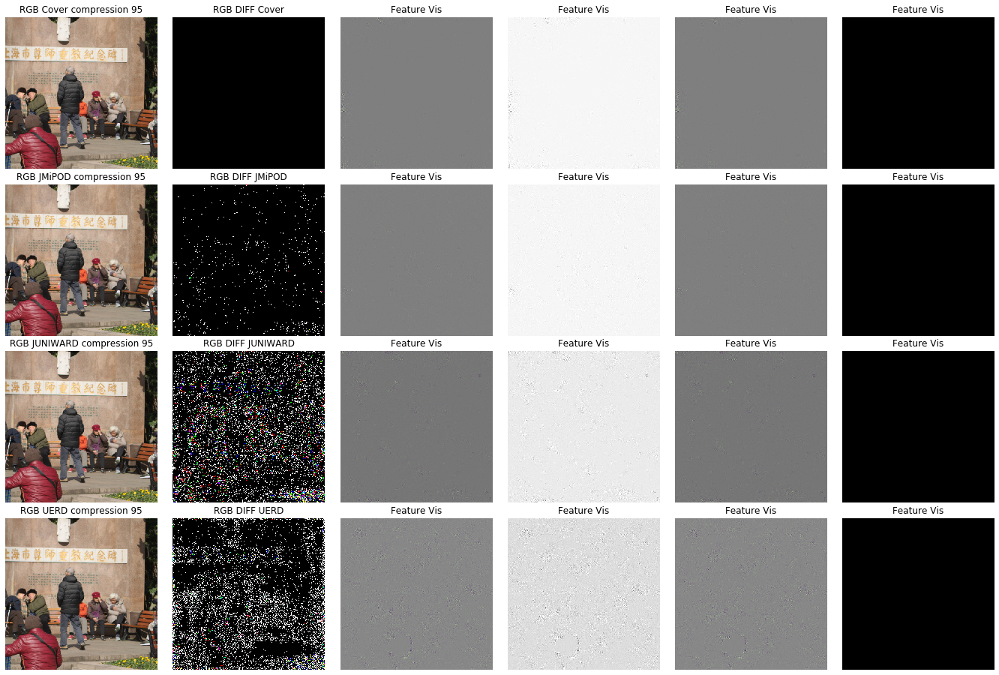

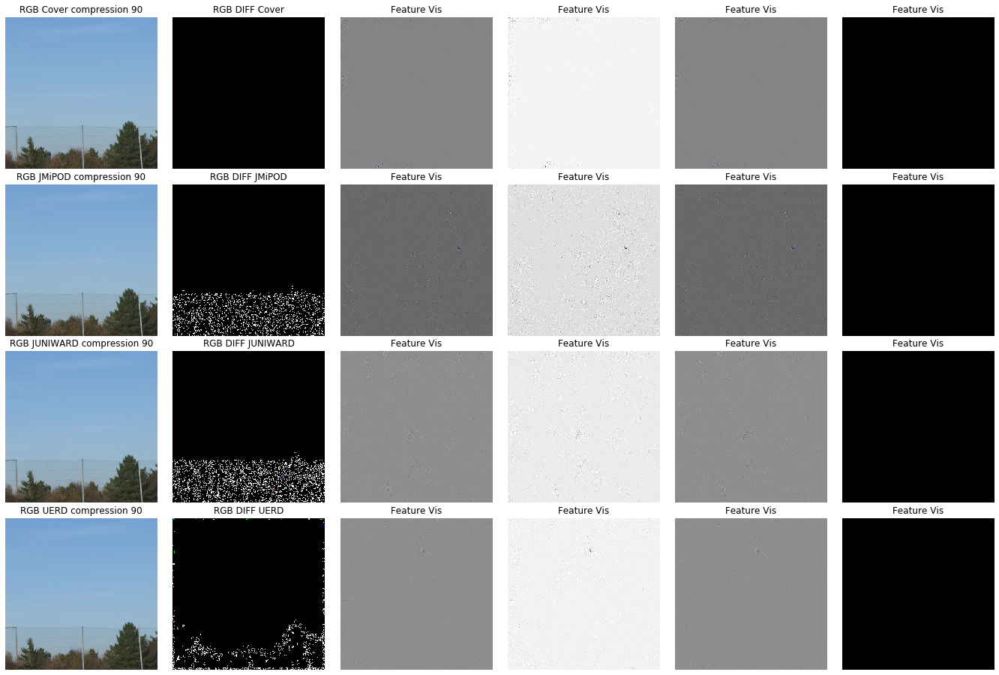

In [51]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

img_path = '/export/data/mdorkenw/data/alaska2/'
methods = ['Cover', 'JMiPOD', 'JUNIWARD', 'UERD']
compre = ['75', '90', '95']

## Select random images for visualization
images = os.listdir(img_path + 'Cover/')
compression = np.asarray(np.load(img_path + 'JPEG_compression.npy'))
rand = np.random.randint(0, len(images), 60)
rand_img = [images[i] for i in rand]


for jo in range(10):
    fig, axs = plt.subplots(4, 6, figsize=(24,16))
    fig.subplots_adjust(hspace = 0.1, wspace=.001)

    comp = compression[rand[jo]]
    imgs = [Image.open(img_path + met + '/' + rand_img[jo]) for met in methods]

    for i in range(4):
        prep_img = dloader.load_and_augment_RGB(img_path + methods[i] + '/' + images[i]).unsqueeze(0)
        grad_imgs = get_grad_imgs(model, prep_img, i*3 + comp)
        for j in range(6):
            image = imgs[i]
            if j == 0:
                axs[i, j].imshow(image)
                axs[i, j].set_title('RGB ' + methods[i] + f' compression {compre[comp]}')
                axs[i, j].axis('off')
            if j == 1:
                axs[i, j].imshow(np.array(imgs[0])-np.array(image))
                axs[i, j].set_title('RGB DIFF ' + methods[i])
                axs[i, j].axis('off')
            if j > 1:
                grad_img = grad_imgs[j-2].swapaxes(0,2).swapaxes(0,1)
                if grad_img.shape[-1] == 1:
                    axs[i, j].imshow(grad_img[:, :, 0], cmap='gray')
                else:
                    axs[i, j].imshow(grad_img)
                axs[i, j].axis('off')
                axs[i, j].set_title(f'Feature Vis')

    plt.savefig('visualization/feature/img_'+ str(jo) + '.png', dpi=100)

In [50]:
grad_imgs[1]

array([[[0.88377154, 0.8613998 , 0.8786965 , ..., 0.8938448 ,
         0.863859  , 0.8730975 ],
        [0.8621612 , 0.87869054, 0.85474986, ..., 0.79310405,
         0.88471293, 0.8602869 ],
        [0.9175245 , 0.8346634 , 0.88144845, ..., 0.95112526,
         0.87195003, 0.8709761 ],
        ...,
        [0.881828  , 0.8728944 , 0.8920329 , ..., 0.89954466,
         0.87899256, 0.86936605],
        [0.8745827 , 0.8578055 , 0.8779556 , ..., 0.8483529 ,
         0.8491259 , 0.8738067 ],
        [0.87074697, 0.8700339 , 0.8738994 , ..., 0.8619307 ,
         0.8755357 , 0.8699775 ]]], dtype=float32)

## Create ROC curve

In [33]:
## Create predictions on test set
import torch.nn as nn
_ = model.eval().cuda()

logits_collect = []; labels_collect = []
data_loader   = torch.utils.data.DataLoader(dloader, num_workers=10, batch_size=10, shuffle=False)
data_iter = tqdm(data_loader, position=2)

with torch.no_grad():
    for image_idx, file_dict in enumerate(data_iter):

        input = file_dict["input"].type(torch.FloatTensor).cuda()
        label = file_dict["label"].type(torch.FloatTensor).cuda()
        mask = file_dict["mask"].type(torch.FloatTensor).cuda()
        
        logits = model(input, mask)
        logits_collect.append(logits.detach().cpu())
        label = np.argmax(label.cpu().data.numpy(), axis=1)
        labels_collect.append(label)

logits = torch.cat(logits_collect, dim=0)
label = np.concatenate(labels_collect, axis=0)
pred = 1 - np.sum(nn.functional.softmax(logits, dim=1).numpy()[:, :3], axis=1)
label[label<3]  = 0
label[label>=3] = 1

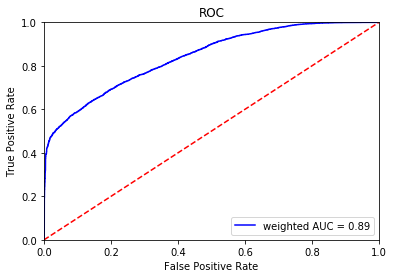

In [43]:
import sklearn.metrics as metrics
import matplotlib.pyplot as plt

# calculate the fpr and tpr for all thresholds of the classification
fpr, tpr, threshold = metrics.roc_curve(label, pred)
roc_auc = aux.auc_weighted(label, pred)

plt.title('ROC')
plt.plot(fpr, tpr, 'b', label = 'weighted AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.savefig('visualization/ROC.png', dpi=100)
plt.show()